In [5]:
import torch
import torch.nn.functional as F
from torch import nn
import pandas as pd
import matplotlib.pyplot as plt # for making figures
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
from pprint import pprint

In [6]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cpu')

In [7]:
!wget https://cs.stanford.edu/people/karpathy/char-rnn/warpeace_input.txt -O names-long.txt

--2024-10-28 21:31:17--  https://cs.stanford.edu/people/karpathy/char-rnn/warpeace_input.txt
Resolving cs.stanford.edu (cs.stanford.edu)... 171.64.64.64
Connecting to cs.stanford.edu (cs.stanford.edu)|171.64.64.64|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3258246 (3.1M) [text/plain]
Saving to: ‘names-long.txt’

names-long.txt      100%[===================>]   3.11M   734KB/s    in 4.3s    

2024-10-28 21:31:23 (734 KB/s) - ‘names-long.txt’ saved [3258246/3258246]



In [8]:
!head names-long.txt

"Well, Prince, so Genoa and Lucca are now just family estates of the
Buonapartes. But I warn you, if you don't tell me that this means war,
if you still try to defend the infamies and horrors perpetrated by that
Antichrist--I really believe he is Antichrist--I will have nothing more
to do with you and you are no longer my friend, no longer my 'faithful
slave,' as you call yourself! But how do you do? I see I have frightened
you--sit down and tell me all the news."

It was in July, 1805, and the speaker was the well-known Anna Pavlovna
Scherer, maid of honor and favorite of the Empress Marya Fedorovna. With


In [9]:
with open('names-long.txt', 'r') as file:
    text = file.read()

paragraphs = text.lower().strip().split('\n\n')

for idx, para in enumerate(paragraphs):

    words = para.split()
    words = [word for word in words if word.isalpha()]

    words = [word for word in words if 0 < len(word) < 10]

    words = [''.join([ch for ch in word if ch.isalpha()]) for word in words]

    paragraphs[idx] = words

print(paragraphs[0])
print(len(paragraphs))


['so', 'genoa', 'and', 'lucca', 'are', 'now', 'just', 'family', 'estates', 'of', 'the', 'but', 'i', 'warn', 'if', 'you', 'tell', 'me', 'that', 'this', 'means', 'if', 'you', 'still', 'try', 'to', 'defend', 'the', 'infamies', 'and', 'horrors', 'by', 'that', 'really', 'believe', 'he', 'is', 'will', 'have', 'nothing', 'more', 'to', 'do', 'with', 'you', 'and', 'you', 'are', 'no', 'longer', 'my', 'no', 'longer', 'my', 'as', 'you', 'call', 'but', 'how', 'do', 'you', 'i', 'see', 'i', 'have', 'down', 'and', 'tell', 'me', 'all', 'the']
11349


In [10]:
# Create vocabulary of words instead of characters
total_words = []
for para in paragraphs:
    for word in para:
        total_words.append(word)

unique_words = sorted(list(set(total_words)))
stoi = {w:i+1 for i,w in enumerate(unique_words)}  # +1 to reserve 0 for padding or special tokens
stoi['.'] = 0  # Optional: Special token for sentence end
itos = {i:w for w,i in stoi.items()}

pprint(itos)


{0: '.',
 1: 'a',
 2: 'ab',
 3: 'aback',
 4: 'abacus',
 5: 'abandon',
 6: 'abandoned',
 7: 'abandons',
 8: 'abashed',
 9: 'abbe',
 10: 'abdomen',
 11: 'abdomens',
 12: 'abduction',
 13: 'ability',
 14: 'able',
 15: 'abnormal',
 16: 'abolition',
 17: 'abounding',
 18: 'about',
 19: 'above',
 20: 'abramovna',
 21: 'abreast',
 22: 'abroad',
 23: 'abrupt',
 24: 'abruptly',
 25: 'absence',
 26: 'absent',
 27: 'absently',
 28: 'absolute',
 29: 'absolved',
 30: 'absorb',
 31: 'absorbed',
 32: 'abstain',
 33: 'abstained',
 34: 'abstract',
 35: 'absurd',
 36: 'absurdity',
 37: 'absurdly',
 38: 'abundance',
 39: 'abundant',
 40: 'abuse',
 41: 'abused',
 42: 'abuses',
 43: 'abusing',
 44: 'abyss',
 45: 'accent',
 46: 'accept',
 47: 'accepted',
 48: 'accepting',
 49: 'accepts',
 50: 'access',
 51: 'accident',
 52: 'accidents',
 53: 'acclaimed',
 54: 'accompany',
 55: 'accord',
 56: 'accorded',
 57: 'according',
 58: 'account',
 59: 'accounted',
 60: 'accounts',
 61: 'accuracy',
 62: 'accurate',
 6

In [11]:
import torch

block_size = 10
X, Y = [], []

for para in paragraphs:

    context = ['.'] * block_size

    for i in range(len(para)):

        context = context[1:] + [para[i]]
        target = para[i+1] if i + 1 < len(para) else None

        if target:

            context_indices = [stoi[word] for word in context]
            target_index = stoi[target]


            X.append(context_indices)
            Y.append(target_index)

            print(' '.join(context), '--->', target)

X = torch.tensor(X)
Y = torch.tensor(Y)


. . . . . . . . . so ---> genoa
. . . . . . . . so genoa ---> and
. . . . . . . so genoa and ---> lucca
. . . . . . so genoa and lucca ---> are
. . . . . so genoa and lucca are ---> now
. . . . so genoa and lucca are now ---> just
. . . so genoa and lucca are now just ---> family
. . so genoa and lucca are now just family ---> estates
. so genoa and lucca are now just family estates ---> of
so genoa and lucca are now just family estates of ---> the
genoa and lucca are now just family estates of the ---> but
and lucca are now just family estates of the but ---> i
lucca are now just family estates of the but i ---> warn
are now just family estates of the but i warn ---> if
now just family estates of the but i warn if ---> you
just family estates of the but i warn if you ---> tell
family estates of the but i warn if you tell ---> me
estates of the but i warn if you tell me ---> that
of the but i warn if you tell me that ---> this
the but i warn if you tell me that this ---> means
but i wa

In [22]:
X.shape, X.dtype, Y.shape, Y.dtype

(torch.Size([443649, 10]), torch.int64, torch.Size([443649]), torch.int64)

In [56]:
import torch
import torch.nn as nn
class NextWord(nn.Module):
  def __init__(self, vocab_size, emb_dim, hidden_size):
    super().__init__()
    self.emb = nn.Embedding(vocab_size, emb_dim)
    self.lin1 = nn.Linear(emb_dim, hidden_size)
    self.lin2 = nn.Linear(hidden_size, vocab_size)

  def forward(self, x):
    x = self.emb(x)
    x = torch.relu(self.lin1(x))
    x = self.lin2(x)
    return x

  def generate(self, idx, max_new_tokens=10):
    for _ in range(max_new_tokens):

        if idx.dim() == 1:
          idx = idx.unsqueeze(0)

        idx_cond = idx

        logits = self(idx_cond)
        logits = logits[:,-1, :]

        probs = F.softmax(logits, dim=-1)

        idx_next = torch.multinomial(probs, num_samples=1)

        idx = torch.cat((idx, idx_next), dim=1)
    return idx

In [57]:
model = NextWord(len(stoi), emb_dim=64, hidden_size=1024).to(device)

print(model.generate(X[:11].to(device)).shape)

torch.Size([11, 20])


In [26]:
for param_name, param in model.named_parameters():
    print(param_name, param.shape)

emb.weight torch.Size([12076, 64])
lin1.weight torch.Size([1024, 64])
lin1.bias torch.Size([1024])
lin2.weight torch.Size([12076, 1024])
lin2.bias torch.Size([12076])


In [16]:
# Train the model

opt = torch.optim.AdamW(model.parameters(), lr=0.01)
model.to(device)
import time

batch_size = 10000
print_every = 20
elapsed_time = []

for epoch in range(500):
    start_time = time.time()
    for i in range(0, X.shape[0], batch_size):
        x = X[i:i+batch_size].to(device)
        y = Y[i:i+batch_size].to(device)  # Get target batch
        y_pred = model(x)  # Forward pass

        y_pred = y_pred[:,-1,:].view(-1, len(stoi))
        y = y.view(-1)

        loss = F.cross_entropy(y_pred, y)
        loss.backward()
        opt.step()
        opt.zero_grad()

        del x, y

    end_time = time.time()
    elapsed_time.append(end_time - start_time)

    if epoch % print_every == 0:
        print(f"Epoch: {epoch}, Loss: {loss.item()}")  # Print loss at intervals


Epoch: 0, Loss: 5.67480993270874
Epoch: 20, Loss: 4.186345100402832
Epoch: 40, Loss: 4.143764019012451


In [118]:
model = NextWord(len(stoi), emb_dim=64, hidden_size=1024).to(device)
model.load_state_dict(torch.load("next_word_model_relu_64_10.pth", map_location=torch.device('cpu')))

/var/folders/jv/6j759gh52pjg5xgj136xc96w0000gn/T/ipykernel_9449/1776016312.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("next_word_mo

<All keys matched successfully>

In [119]:
model.eval()
text = "of the but i warn if you tell me that"
with torch.no_grad():

  token = torch.tensor([stoi[word] for word in text.split()]).to(device)
  pred = model.generate(token)

In [120]:
' '.join([itos[word.item()] for word in pred[0]])

'of the but i warn if you tell me that the causing me about like straining each thoughts of his'

In [121]:
from sklearn.manifold import TSNE

# Function to visualize the embedding in 2D space using t-SNE
def plot_emb(emb, itos, tokens, ax=None):
    if ax is None:
        fig, ax = plt.subplots()

    # Use t-SNE to reduce dimensions to 2D
    tsne = TSNE(n_components=2, random_state=0)
    reduced_emb = tsne.fit_transform(emb.weight.detach().cpu().numpy())

    for i in tokens:
        x, y = reduced_emb[i]
        ax.scatter(x, y, color='k')
        ax.text(x + 0.05, y + 0.05, itos[i])
    return ax

In [122]:
# Embedding layer for the context
emb_dim = 64
emb = torch.nn.Embedding(len(stoi), emb_dim)

<Axes: >

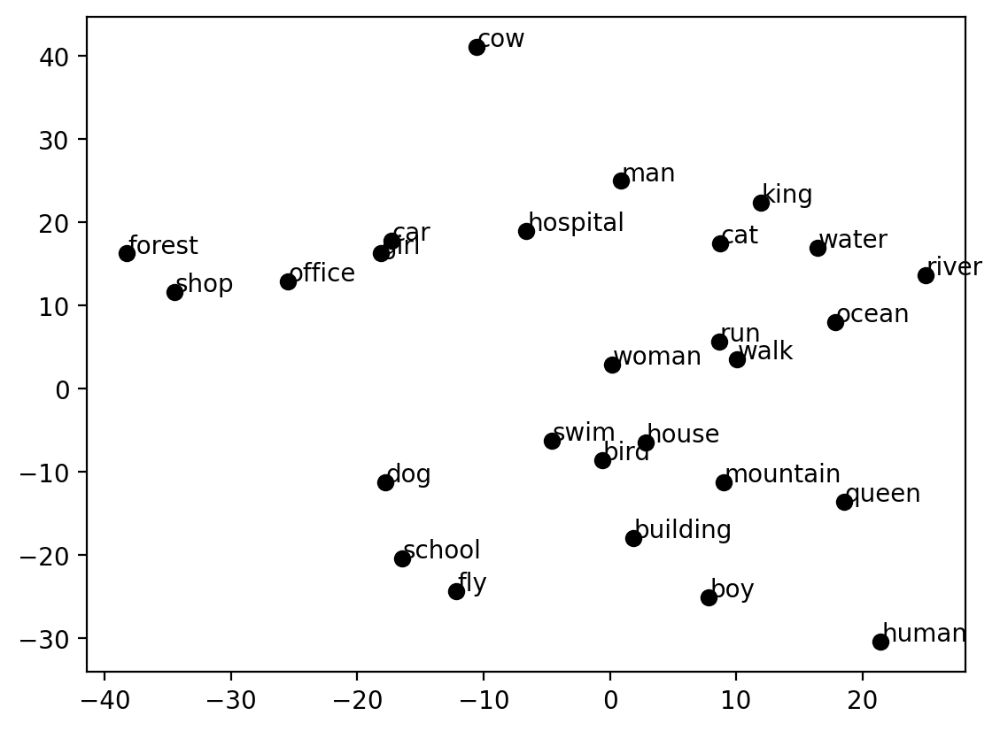

In [123]:
import numpy as np

tokens = np.random.randint(0, len(itos), 100)
tokens = [6290, 11899, 4194, 4512, 8800, 7067, 11657, 6703, 1228, 1023, 5151, 1516, 3015, 1569, 2282, 5133, 5114, 1356, 9117, 7089, 9439, 5716, 8175, 8936, 11602, 10487, 4112]

plot_emb(emb, itos, tokens)

<Axes: >

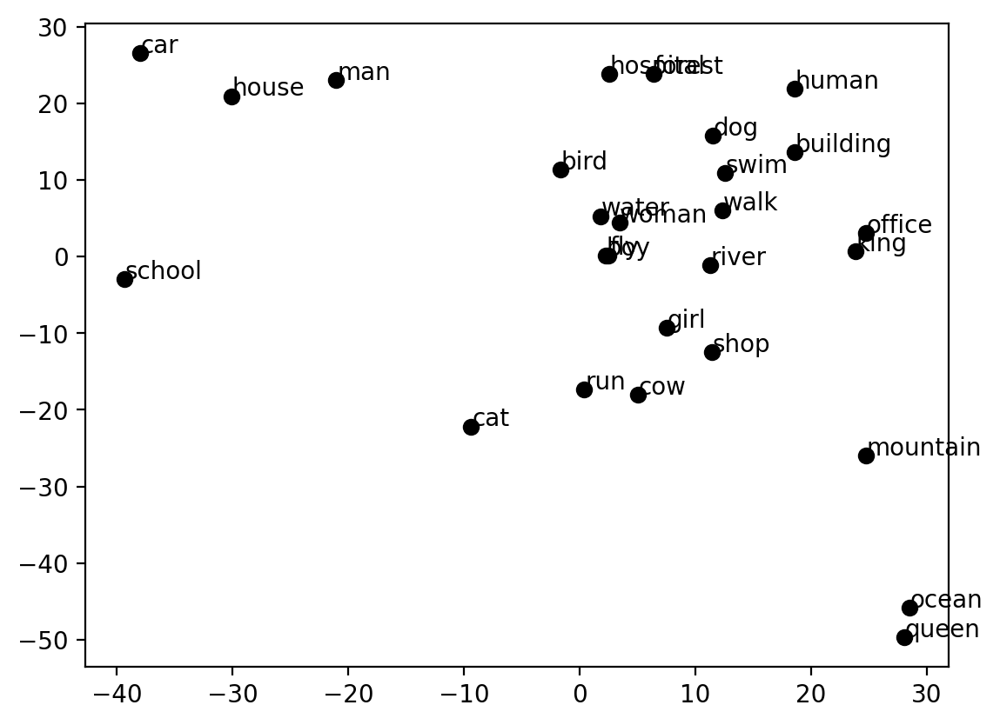

In [124]:
plot_emb(model.emb, itos, tokens)

In [126]:
tsne = TSNE(n_components=2, random_state=0)
reduced_emb = tsne.fit_transform(emb.weight.detach().cpu().numpy())